## Assignment 3

The purpose of this assignment is to use computer vision to extract specific features from images. In particular, we're going to see if we can find text. We are not interested in finding whole words right now; we'll look at how to find whole words in a coming class. For now, we only want to find language-like objects, such as letters and punctuation.

Download and save the image at the link below:

https://upload.wikimedia.org/wikipedia/commons/f/f4/%22We_Hold_These_Truths%22_at_Jefferson_Memorial_IMG_4729.JPG

Using the skills you have learned up to now, do the following tasks:

- Draw a green rectangular box to show a region of interest (ROI) around the main body of text in the middle of the image. Save this as image_with_ROI.jpg.
- Crop the original image to create a new image containing only the ROI in the rectangle. Save this as image_cropped.jpg.
- Using this cropped image, use Canny edge detection to 'find' every letter in the image
- Draw a green contour around each letter in the cropped image. Save this as image_letters.jpg

__TIPS__
Remember all of the skills you've learned so far and think about how they might be useful
- This means: colour models; cropping; masking; simple and adaptive thresholds; binerization; mean, median, and Gaussian blur.
- Experiment with different approaches until you are able to find as many of the letters and punctuation as possible with the least amount of noise. You might not be able to remove all artifacts - that's okay!

__Bonus challenges__
If you want to push yourself, try to write a script which runs from the command line and which takes any similar input (an image containing text) and produce a similar output (a new image with contours drawn around every letter).

__General instructions__
- For this exercise, you can upload either a standalone script OR a Jupyter Notebook
- Save your script as edge_detection.py OR edge_detection.ipynb
- If you have external dependencies, you must include a requirements.txt
- You can either upload the script here or push to GitHub and include a link - or both!
- Your code should be clearly documented in a way that allows others to easily follow along
- Similarly, remember to use descriptive variable names! A name like cropped is more readable than crp.
- The filenames of the saved images should clearly relate to the original image

__Purpose__
This assignment is designed to test that you have a understanding of:
- how to use a variety of image processing steps;
- how to perform edge detection;
- how to combine these skills in order to find specific features in an image

---

__Loading Dependencies__

In [1]:
# import dependencies
import os
import sys
sys.path.append(os.path.join(".."))
import cv2
import numpy as np
from utils.imutils import jimshow
from utils.imutils import jimshow_channel
import matplotlib.pyplot as plt

Matplotlib is building the font cache; this may take a moment.


__Loading Image__

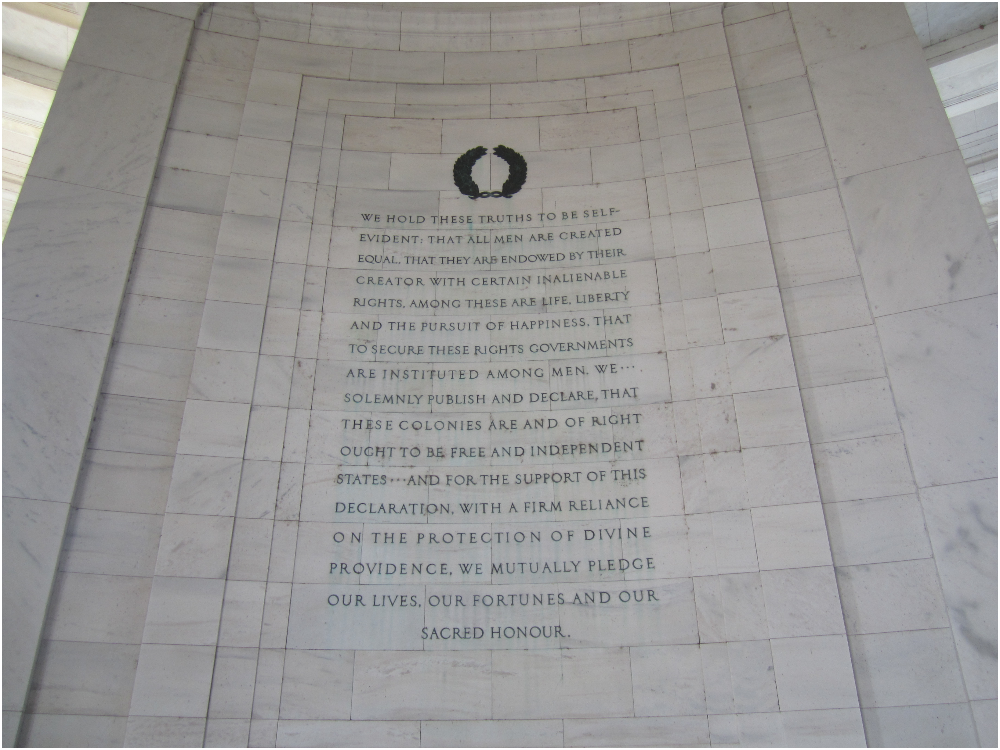

In [2]:
# read image
image_path = os.path.join("..", "data", "img", "weholdtruths.jpeg")
image = cv2.imread(image_path)
jimshow(image)

In [10]:
image.shape

(3240, 4320, 3)

__ROI Box__

In [93]:
# defining points to make text box
top_left_corner = (1400,890)
bottom_right_corner = (2900,2800)

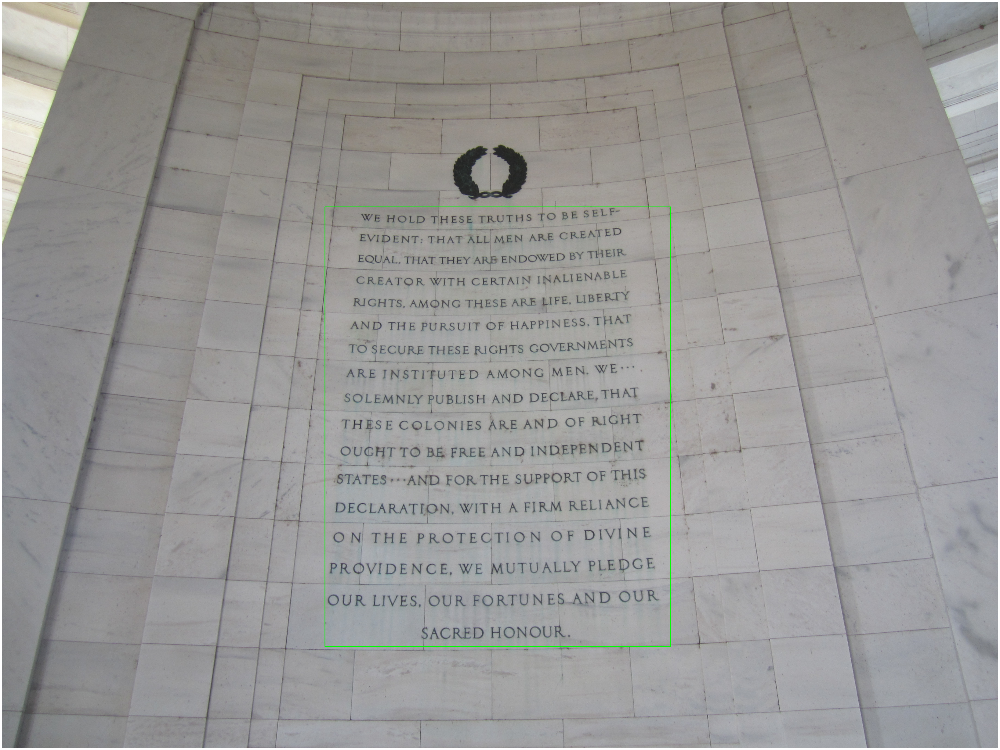

In [95]:
# drawing rectangle around ROI
image_ROI = cv2.rectangle(image.copy(), top_left_corner, bottom_right_corner, (0,255,0), (2))
# displaying image with box
jimshow(image_ROI)

In [20]:
# saving the image
#cv2.imwrite("image_with_ROI.jpg", ROI_image)

True

__Cropping Image__

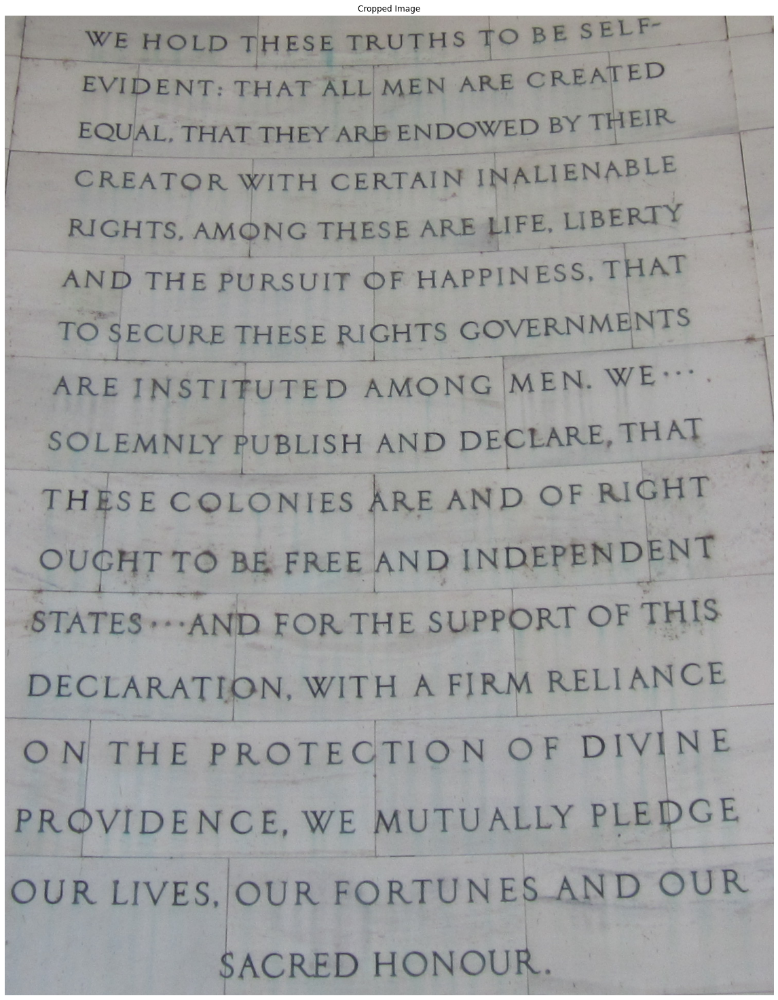

In [96]:
# crop image based on points defined above
cropped_image = image.copy()[top_left_corner[1]:bottom_right_corner[1], top_left_corner[0]:bottom_right_corner[0]]
# show cropped image
jimshow(cropped_image, "Cropped Image")

__Preprocessing Image__

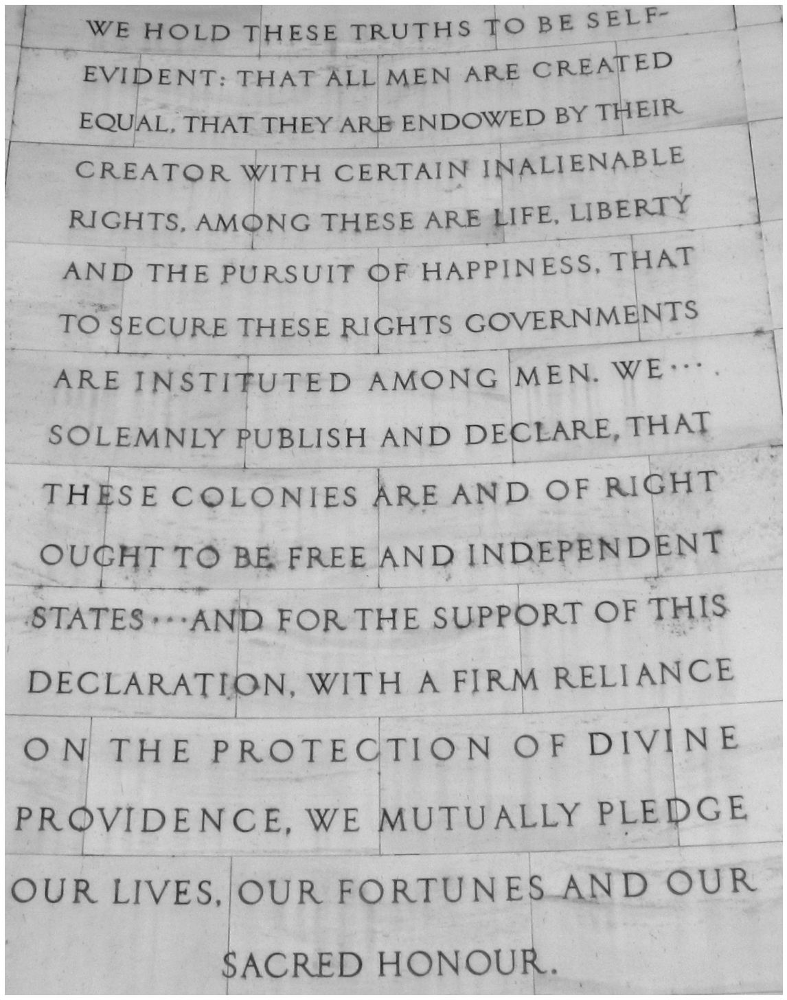

In [97]:
# make image on grey scale
grey_image = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2GRAY)
jimshow_channel(grey_image)

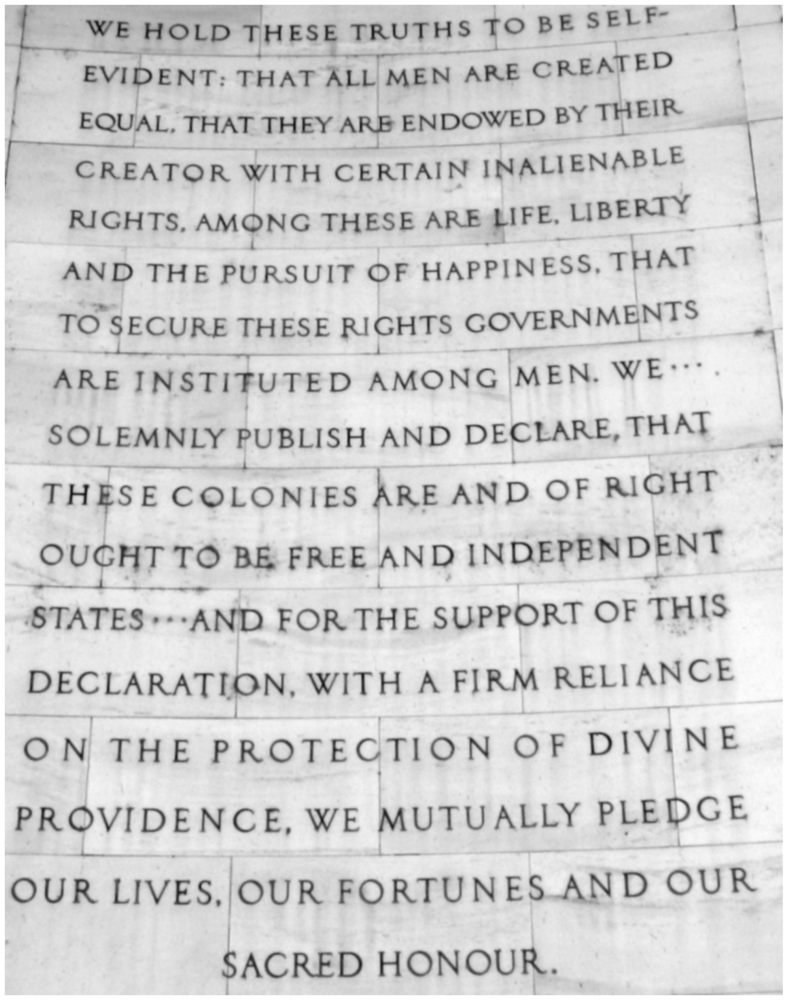

In [98]:
# blur image
blurred_image = cv2.GaussianBlur(grey_image, (7,7), 0)
jimshow_channel(blurred_image)

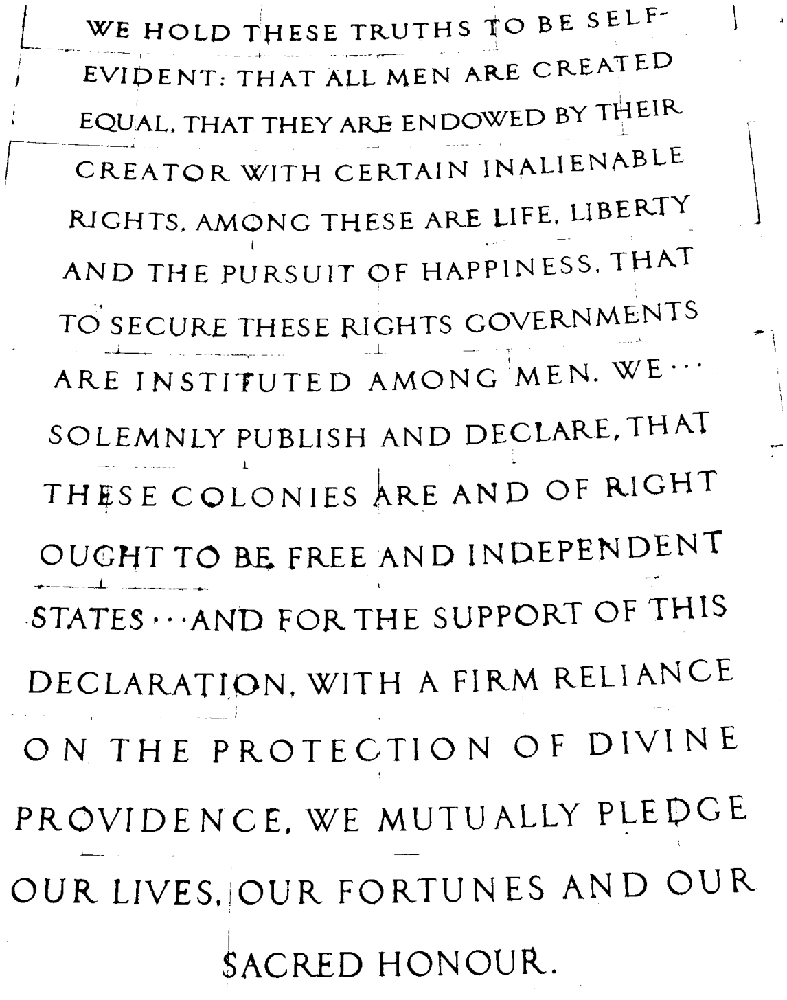

In [102]:
# thresholding to make it only black/white
_, threshold_image = cv2.threshold(grey_image, 115, 255, cv2.THRESH_BINARY)
jimshow_channel(threshold_image)

In [114]:
# apply canny
canny_image = cv2.Canny(blurred_image, 70, 150)

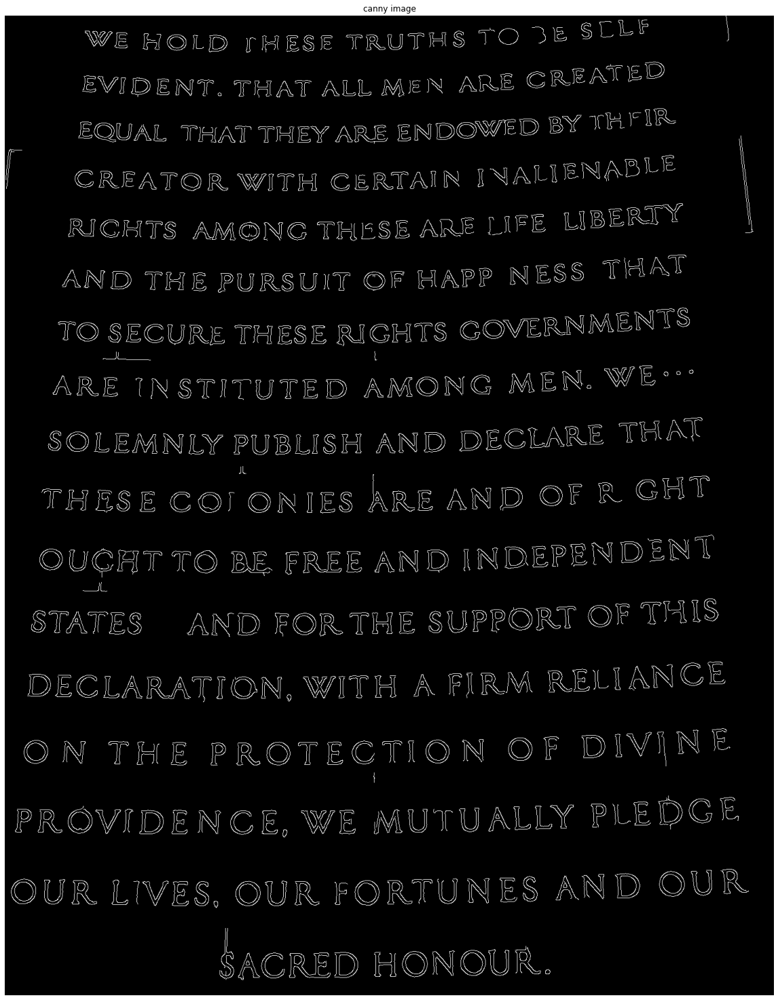

In [115]:
jimshow_channel(canny_image, "canny image")

__Contouring Letters__

In [116]:
(contours, _) = cv2.findContours(canny_image.copy(), 
                           cv2.RETR_EXTERNAL, 
                           cv2.CHAIN_APPROX_SIMPLE)

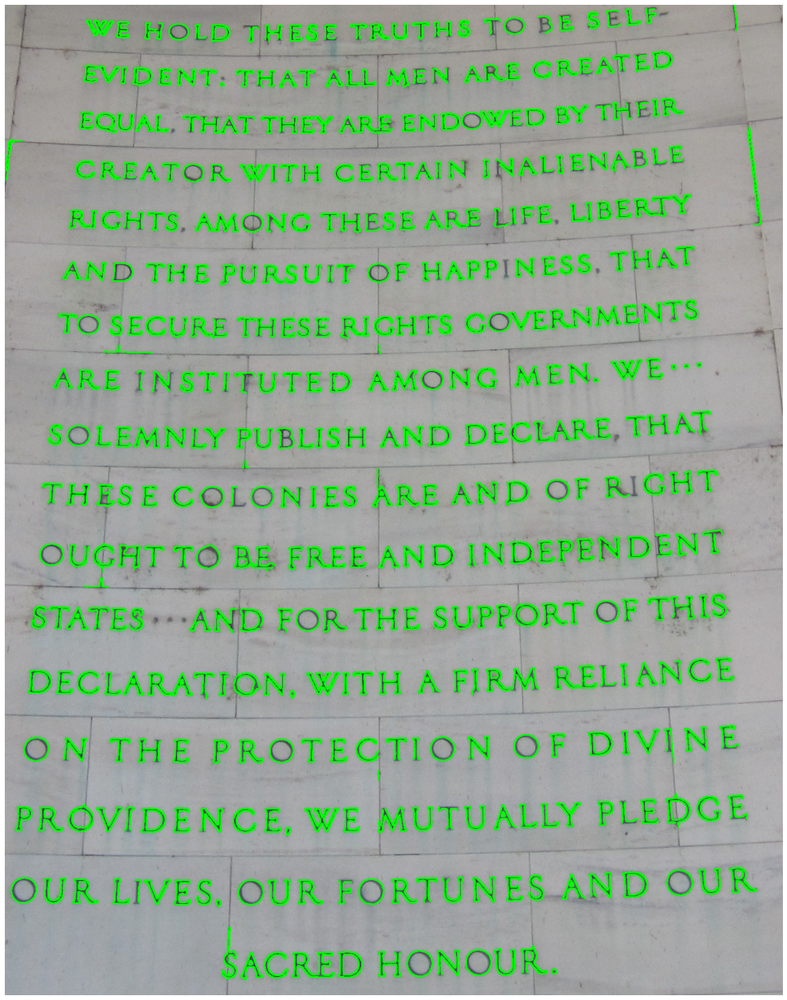

In [117]:
jimshow(cv2.drawContours(cropped_image.copy(),  # draw contours on original
                         contours,      # list of contours
                         -1,            # which contours
                         (0,255,0),     # contour color
                         2))  

## Meme Image with White Text

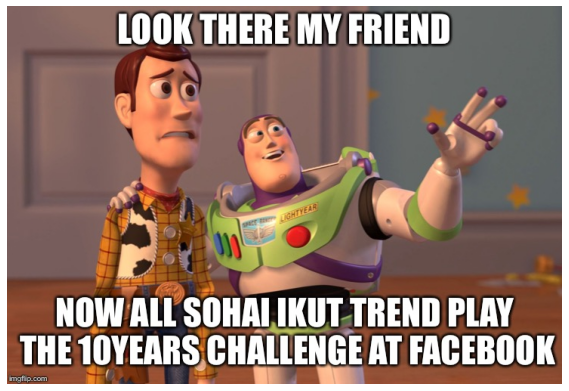

In [78]:
# load meme
meme_path = os.path.join("..", "..", "meme-data", "memotion_dataset_7k", "images", "image_1.jpg")
meme = cv2.imread(meme_path)
jimshow(meme)

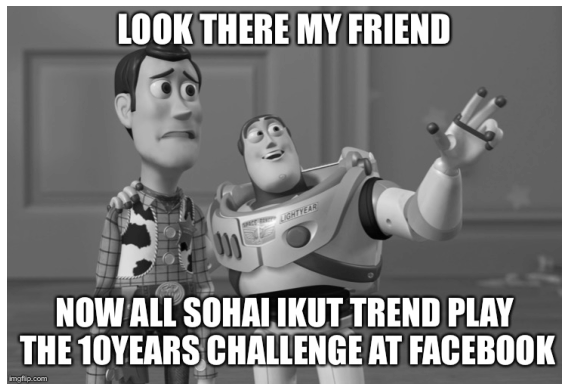

In [87]:
# put onto greyscale
grey_meme = cv2.cvtColor(meme, cv2.COLOR_BGR2GRAY)
jimshow_channel(grey_meme)

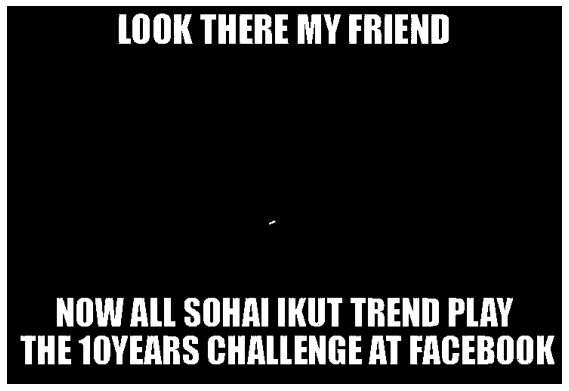

In [88]:
# thresholding to make it only black/white
_, threshold_meme = cv2.threshold(grey_meme, 245, 255, cv2.THRESH_BINARY)
jimshow_channel(threshold_meme)

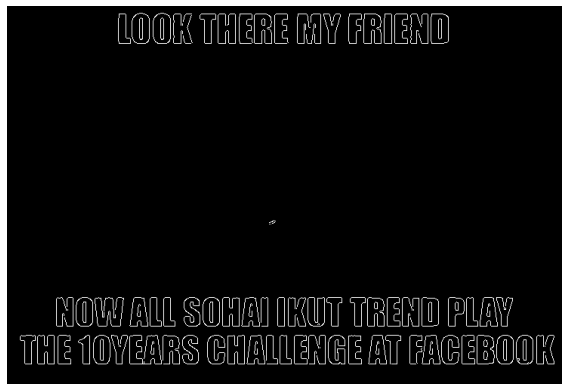

In [91]:
# apply canny edge detection
canny_meme = cv2.Canny(threshold_meme, 245, 255)
jimshow_channel(canny_meme)

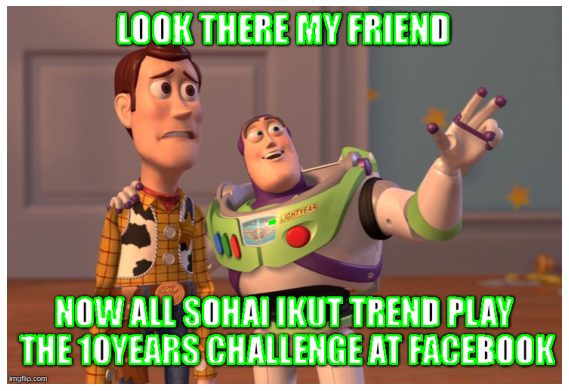

In [92]:
# draw contours
(contours, _) = cv2.findContours(canny_meme.copy(), 
                           cv2.RETR_EXTERNAL, 
                           cv2.CHAIN_APPROX_SIMPLE)
jimshow(cv2.drawContours(meme.copy(),  # draw contours on original
                         contours,      # list of contours
                         -1,            # which contours
                         (0,255,0),     # contour color
                         2))  

## Meme Image with Black Text

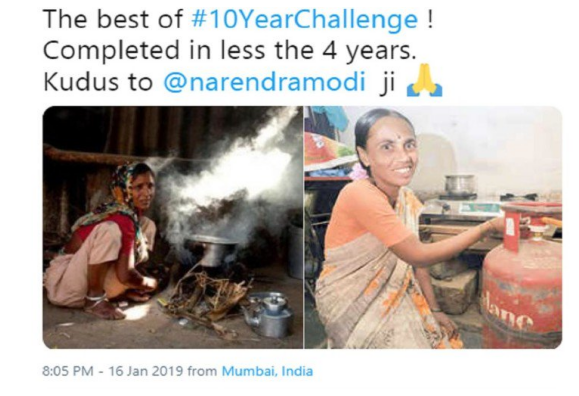

In [53]:
meme_path = os.path.join("..", "..", "meme-data", "memotion_dataset_7k", "images", "image_2.jpeg")
meme = cv2.imread(meme_path)
jimshow(meme)

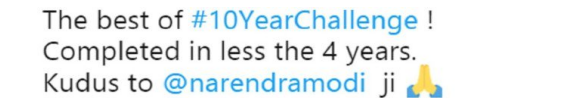

In [65]:
cropped_meme = meme[0:120,0:meme.shape[1]]
jimshow(cropped_meme)

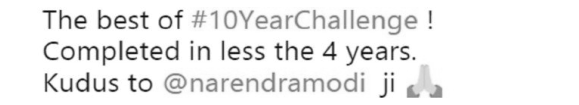

In [66]:
grey_meme = cv2.cvtColor(cropped_meme, cv2.COLOR_BGR2GRAY)
jimshow_channel(grey_meme)

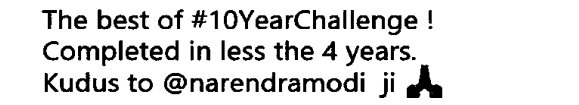

In [70]:
th, threshold_meme = cv2.threshold(grey_meme, 220, 255, cv2.THRESH_BINARY)
jimshow_channel(threshold_meme)

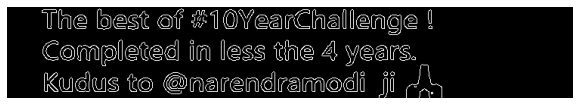

In [71]:
canny_meme = cv2.Canny(threshold_meme, 100, 120)
jimshow_channel(canny_meme)

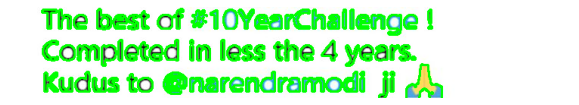

In [72]:
(contours, _) = cv2.findContours(canny_meme.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
jimshow(cv2.drawContours(cropped_meme.copy(),  # draw contours on original
                         contours,      # list of contours
                         -1,            # which contours
                         (0,255,0),     # contour color
                         2)) 